# `l2hmc`: Example

<a href="https://arxiv.org/abs/2105.03418"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2105.03418-B31B1B.svg" align="left"></a> <a href="https://arxiv.org/abs/2112.01582"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2112.01582-B31B1B.svg" align="left" style="margin-left:10px;"></a><br>


This notebook will (attempt) to walk through the steps needed to successfully instantiate and "run" an experiment.

For this example, we wish to train the L2HMC sampler for the 2D $U(1)$ lattice gauge model with Wilson action:

$$
S_{\beta}(n) = \beta \sum_{n}\sum_{\mu<\nu}\mathrm{Re}\left[1 - U_{\mu\nu}(n) \right]
$$

This consists of the following steps:
  1. Build an `Experiment` by parsing our configuration object
  2. Train our model using the `Experiment.train()` method
  3. Evaluate our trained model `Experiment.evaluate(job_type='eval')`
  4. Compare our trained models' performance against generic HMC `Experiment.evaluate(job_type='hmc')`
  

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.1);color:#666666; border-radius:5px; border: none;">
<span style="font-weight:700; font-size:1.5em;">Evaluating Performance</span>
    
Explicitly, we measure the performance of our model by comparing the _tunneling rate_ $\delta Q$ of our **trained** sampler to that of generic HMC.
    
Explicitly, the tunneling rate is given by:
    
$$
\delta Q = \frac{1}{N_{\mathrm{chains}}}\sum_{\mathrm{chains}} \left|Q_{i+1} - Q_{i}\right|
$$
    
where the difference is between subsequent states in a chain, and the sum is over all $N$ chains (each being ran in parallel, _independently_).
    
Since our goal is to generate _independent configurations_, the more our sampler tunnels between different topological sectors (_tunneling rate_), the more efficient our sampler.
    
</div>


## Imports / Setup

In [1]:
! nvidia-smi | tail --lines -7

|=============================================================================|
|    1   N/A  N/A    185696      C   ...PU/2023-04-26/bin/python3     1037MiB |
|    3   N/A  N/A    185697      C   ...PU/2023-04-26/bin/python3     1037MiB |
|    4   N/A  N/A    185698      C   ...PU/2023-04-26/bin/python3     1037MiB |
|    5   N/A  N/A    185699      C   ...PU/2023-04-26/bin/python3     1037MiB |
|    6   N/A  N/A    185700      C   ...PU/2023-04-26/bin/python3     1037MiB |
+-----------------------------------------------------------------------------+



In [3]:
%load_ext autoreload
%autoreload 2
%matplotlib widget

import os
import warnings

os.environ['MASTER_PORT'] = '3456'
warnings.filterwarnings('ignore')

In [4]:
# automatically detect and reload local changes to modules
%load_ext autoreload
%autoreload 2

import os
# --------------------------------------
# BE SURE TO GRAB A FRESH GPU !
os.environ['CUDA_VISIBLE_DEVICES'] = '2'
!echo $CUDA_VISIBLE_DEVICES
# --------------------------------------

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
2


In [5]:
devices = os.environ.get('CUDA_VISIBLE_DEVICES', None)
print(devices)
!getconf _NPROCESSORS_ONLN

2
256


In [6]:
os.environ['TORCH_CPP_LOG_LEVEL'] = 'ERROR'
os.environ['AUTOGRAPH_VERBOSITY'] = '10'
#os.environ['CUDA_VISIBLE_DEVICES'] = '0'
!echo $CUDA_VISIBLE_DEVICES

2


In [14]:
from __future__ import absolute_import, print_function, annotations, division
%matplotlib widget

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import set_matplotlib_formats

from l2hmc.main import build_experiment
from l2hmc.utils.plot_helpers import set_plot_style

set_plot_style()
plt.rcParams['grid.alpha'] = 0.8
plt.rcParams['grid.color'] = '#404040'
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
set_matplotlib_formats('retina')
plt.rcParams['figure.figsize'] = [12.4, 4.8]
import seaborn as sns
from l2hmc.utils.plot_helpers import set_plot_style
#console = get_console()
#print(console.is_jupyter)
#if console.is_jupyter:
#    console.is_jupyter = False
#print(console.is_jupyter)

# Initialize and Build `Experiment` objects:

- The `l2hmc.main` module provides a function `build_experiment`:

```python
def build_experiment(overrides: list[str]) -> tfExperiment | ptExperiment:
    ...
```

which will:

1. Load the default options from `conf/config.yaml`
2. Override the default options with any values provided in `overrides`
3. Parse these options and build an `ExperimentConfig` which uniquely defines an experiment
3. Instantiate / return an `Experiment` from the `ExperimentConfig`.
   Depending on `framework=pytorch|tensorflow`:
    a. `framework=pytorch` -> `l2hmc.experiment.pytorch.Experiment`
    b. `framework=tensorflow` -> `l2hmc.experiment.tensorflow.Experiment`

```python
>>> train_output = experiment.train()
>>> eval_output = experiment.evaluate(job_type='eval')
>>> hmc_output = experiment.evaluate(job_type='hmc')
```

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.2);color:rgb(102,102,102); border-radius:5px; border:none">
<b><u>Overriding Defaults</u></b>

Specifics about the training / evaluation / hmc runs can be flexibly overridden by passing arguments to the training / evaluation / hmc runs, respectively
</div>

In [9]:
import numpy as np

seed = np.random.randint(100000)

DEFAULTS = {
    'seed': f'{seed}',
    'init_aim': False,
    'init_wandb': False,
    'use_wandb': False,
    'restore': False,
    'save': False,
    'use_tb': False,
    'dynamics': {
        'nleapfrog': 10,
        'nchains': 4096,
    },
    'conv': 'none',
    'steps': {
        'log': 10,
        'print': 100,
        'nepoch': 1000,
        'nera': 1,
    },
    'annealing_schedule': {
        'beta_init': 4.0,
        'beta_final': 4.0,
    },
}

outputs = {
    'pytorch': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
    'tensorflow': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
}

In [10]:
from l2hmc.configs import dict_to_list_of_overrides
OVERRIDES = dict_to_list_of_overrides(DEFAULTS)

In [11]:
# Build PyTorch Experiment
ptExpU1 = build_experiment(
    overrides=[
        *OVERRIDES,
        'framework=pytorch',
        'backend=DDP',
        'precision=fp16',
    ]
)

[06/09/23 18:44:42][INFO][dist.py:226] - Caught MASTER_PORT:3456 from environment!
[06/09/23 18:44:42][INFO][dist.py:338] - Global Rank: 0 / 0


2023-06-09 18:44:42.807664: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


[06/09/23 18:44:47][INFO][dist.py:226] - Caught MASTER_PORT:3456 from environment!
[06/09/23 18:44:47][INFO][dist.py:226] - Caught MASTER_PORT:3456 from environment!
[06/09/23 18:44:47][WARNING][trainer.py:435] - Using torch.float16 on cuda!
[06/09/23 18:44:49][WARNING][trainer.py:435] - Using `torch.optim.Adam` optimizer
[06/09/23 18:44:49][INFO][trainer.py:283] - num_params in model: 1486740
[06/09/23 18:44:49][WARNING][trainer.py:250] - logging with freq 10 for wandb.watch


In [12]:
# Build TensorFlow Experiment

import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

tfExpU1 = build_experiment(
    overrides=[
        *OVERRIDES,
        'framework=tensorflow',
        'backend=horovod',
        'precision=fp16',
    ]
)

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA A100-SXM4-80GB, compute capability 8.0
[06/09/23 18:44:53][INFO][dist.py:82] - 1, Physical GPUs and 1 Logical GPUs
[06/09/23 18:44:53][WARNING][dist.py:108] - Using: float32 precision
[06/09/23 18:44:53][INFO][dist.py:109] - RANK: 0, LOCAL_RANK: 0


## PyTorch

### Training

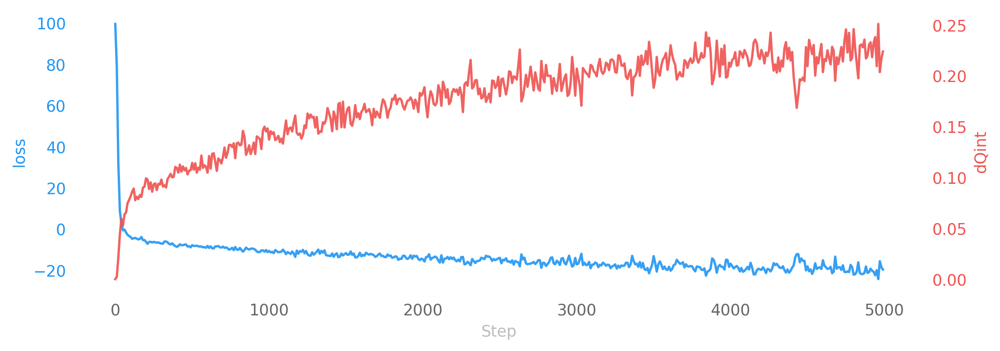

[06/09/23 11:34:37][INFO][trainer.py:439] - [TRAINING] x.dtype: torch.float32
[06/09/23 11:34:37][INFO][trainer.py:439] - [TRAINING] self._dtype: torch.float16
[06/09/23 11:34:37][INFO][trainer.py:107] - ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓
[06/09/23 11:34:37][INFO][trainer.py:108] - ┃ ERA: 0 / 5, BETA: 4.000 ┃
[06/09/23 11:34:37][INFO][trainer.py:109] - ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛
[06/09/23 11:34:42][INFO][trainer.py:439] - Thermalizing configs @ 4.00 took 4.8985 s
[06/09/23 11:34:43][INFO][trainer.py:1722] - era=0 epoch=0 tstep=1 dt=0.837 beta=4.000 loss=99.589 dQsin=0.000 dQint=0.000 energy=409.087 logprob=409.843 logdet=-0.755 sldf=-0.308 sldb=0.162 sld=-0.755 xeps=0.100 veps=0.100 acc=0.000 sumlogdet=-0.000 acc_mask=0.000 plaqs=0.863 intQ=0.035 sinQ=0.027 lr=0.001
[06/09/23 11:37:28][INFO][trainer.py:1722] - era=0 epoch=250 tstep=251 dt=0.609 beta=4.000 loss=-6.267 dQsin=0.210 dQint=0.093 energy=396.824 logprob=396.322 logdet=0.502 sldf=0.262 sldb=0.017 sld=0.502 xeps=0.065 veps=0.061 acc=

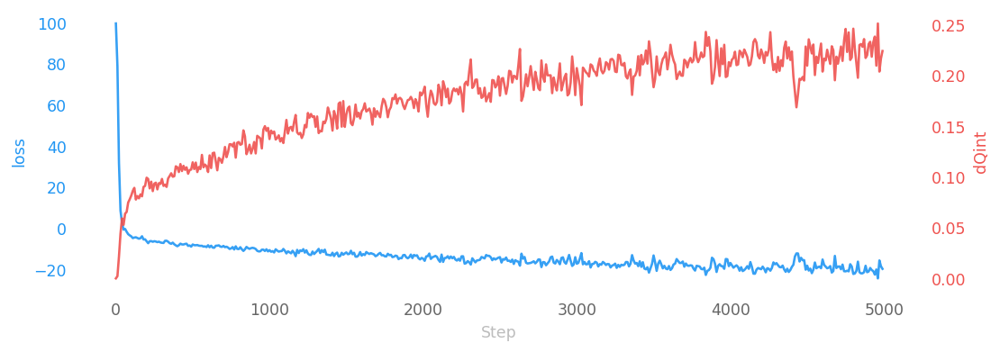

In [12]:
outputs['pytorch']['train'] = ptExpU1.trainer.train()

[06/09/23 12:29:05][INFO][plot_helpers.py:1005] - Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-06-09-113432/pytorch/plots/ridgeplots/svgs/energy_ridgeplot.svg
[06/09/23 12:29:12][INFO][plot_helpers.py:1005] - Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-06-09-113432/pytorch/plots/ridgeplots/svgs/logprob_ridgeplot.svg
[06/09/23 12:29:19][INFO][plot_helpers.py:1005] - Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-06-09-113432/pytorch/plots/ridgeplots/svgs/logdet_ridgeplot.svg
[06/09/23 12:29:24][INFO][plot_helpers.py:1005] - Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-06-09-113432/pytorch/plots/ridgeplots/svgs/sldf_ridgeplot.svg
[06/09/23 12:29:30][INFO][plot_helpers.py:1005] -

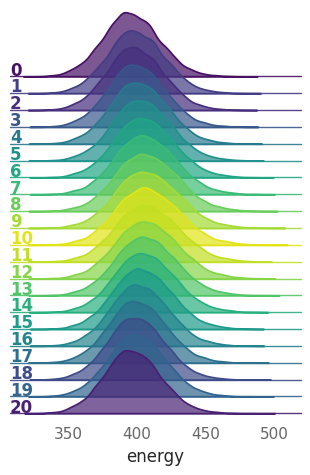

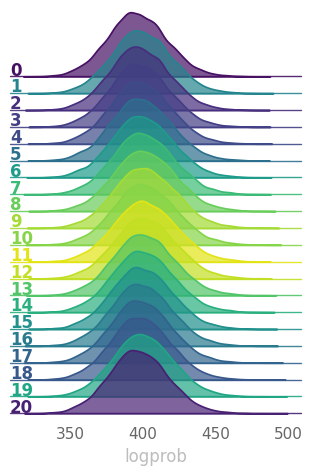

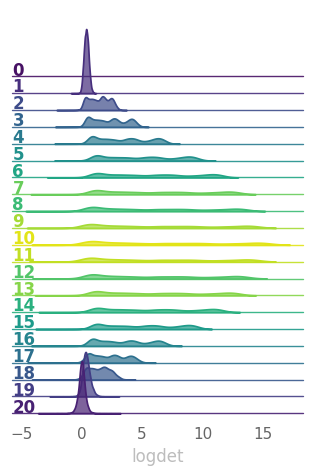

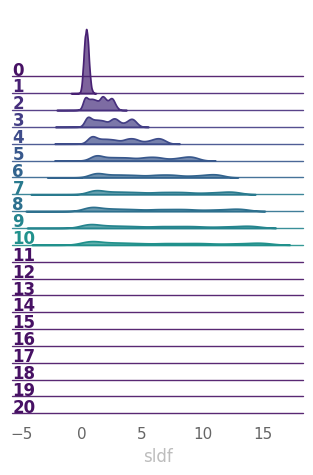

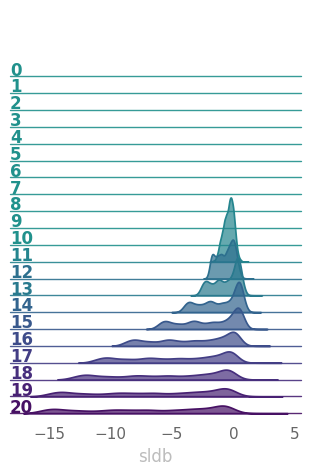

...

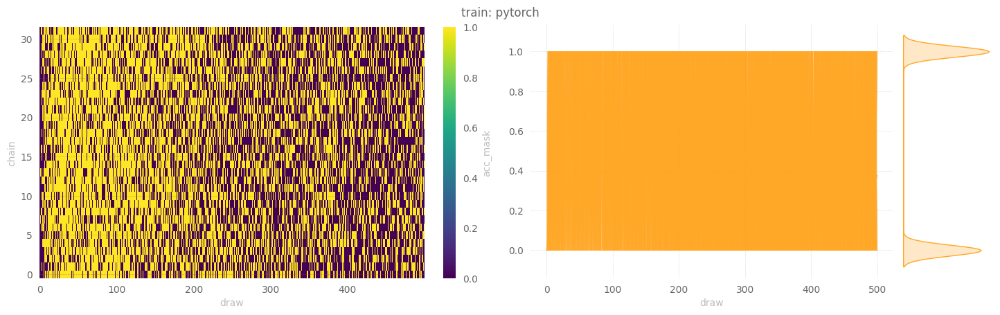

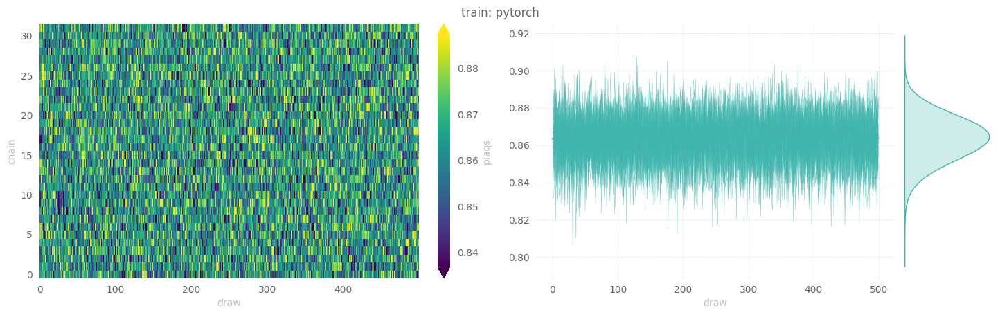

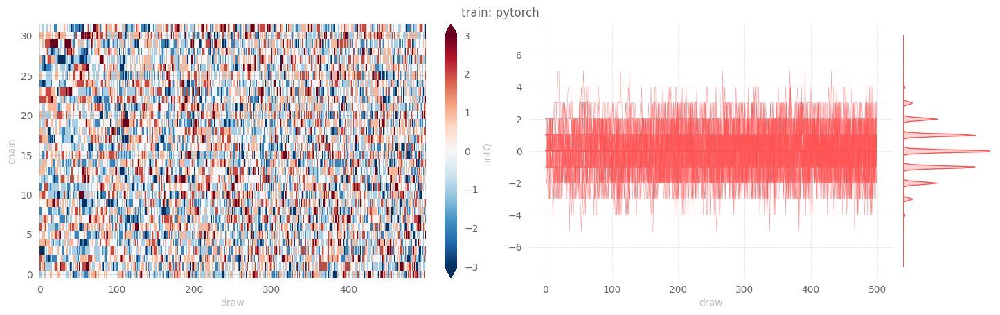

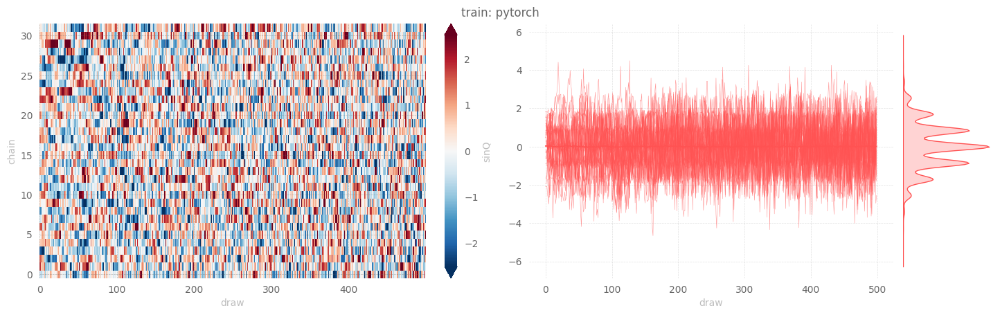

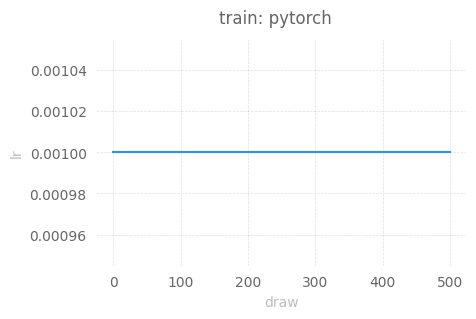

In [13]:
_ = ptExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluation

[06/09/23 12:31:23][WARNING][trainer.py:435] - x.shape (original): torch.Size([4096, 2, 16, 16])
[06/09/23 12:31:23][WARNING][trainer.py:435] - x[:nchains].shape: torch.Size([128, 2, 16, 16])
[06/09/23 12:31:23][INFO][trainer.py:1051] - eps=None
beta=4.0
nlog=10
table=<rich.table.Table object at 0x7f680058ec80>
nprint=500
eval_steps=2000
nleapfrog=None


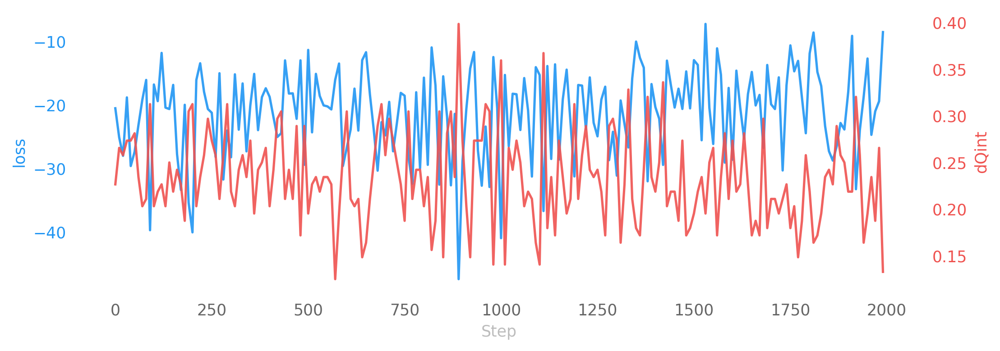

[06/09/23 12:31:27][INFO][trainer.py:1181] - estep=0 dt=0.334 beta=4.000 loss=-20.508 dQsin=0.245 dQint=0.227 energy=410.129 logprob=402.320 logdet=7.808 sldf=4.264 sldb=-3.755 sld=7.808 xeps=0.205 veps=0.154 acc=0.437 sumlogdet=0.047 acc_mask=0.484 plaqs=0.863 intQ=-0.062 sinQ=-0.033
[06/09/23 12:33:34][INFO][trainer.py:1181] - estep=500 dt=0.227 beta=4.000 loss=-11.317 dQsin=0.199 dQint=0.195 energy=409.601 logprob=401.831 logdet=7.770 sldf=4.244 sldb=-3.752 sld=7.770 xeps=0.205 veps=0.154 acc=0.440 sumlogdet=0.018 acc_mask=0.430 plaqs=0.863 intQ=0.094 sinQ=0.090
[06/09/23 12:35:43][INFO][trainer.py:1181] - estep=1000 dt=0.236 beta=4.000 loss=-40.969 dQsin=0.361 dQint=0.359 energy=411.225 logprob=403.462 logdet=7.762 sldf=4.243 sldb=-3.761 sld=7.762 xeps=0.205 veps=0.154 acc=0.442 sumlogdet=-0.005 acc_mask=0.445 plaqs=0.862 intQ=-0.102 sinQ=-0.109
[06/09/23 12:37:52][INFO][trainer.py:1181] - estep=1500 dt=0.225 beta=4.000 loss=-12.927 dQsin=0.197 dQint=0.195 energy=405.012 logprob=39

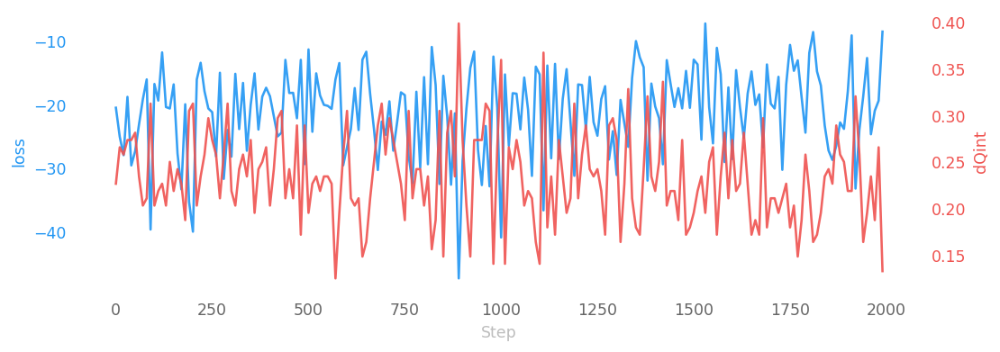

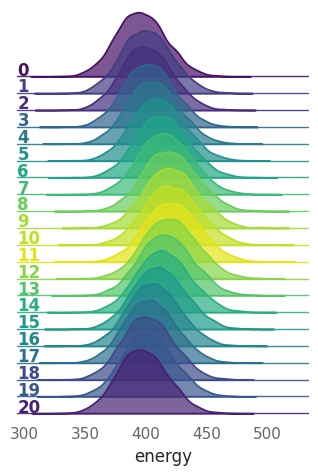

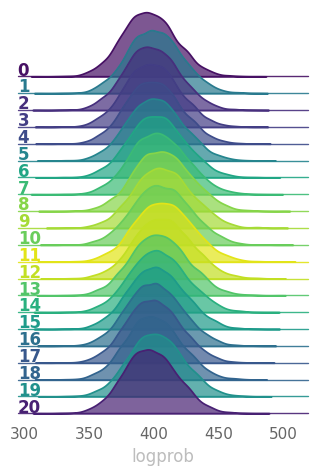

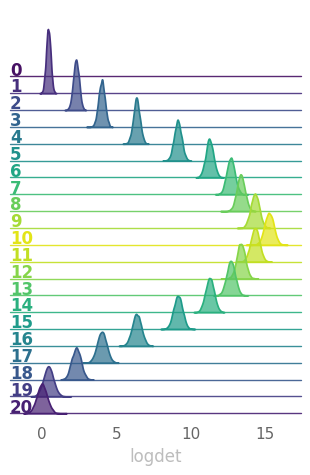

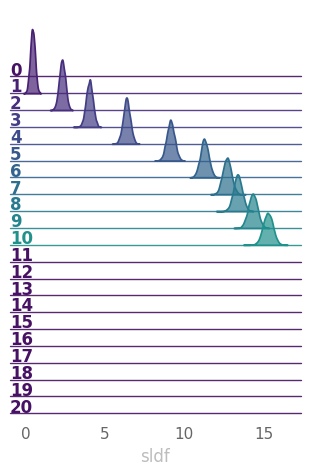

...

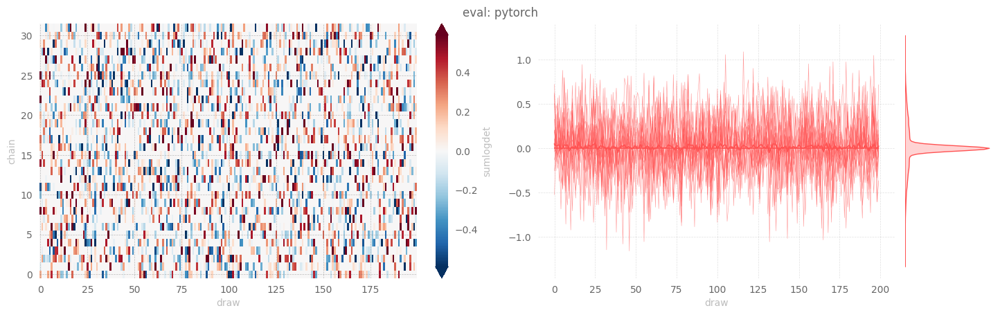

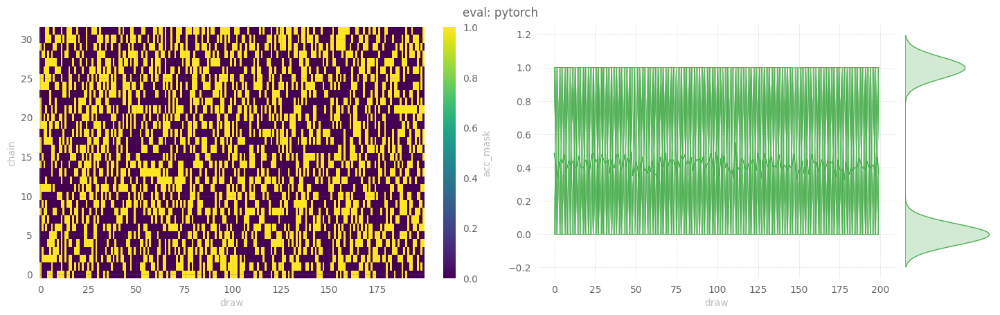

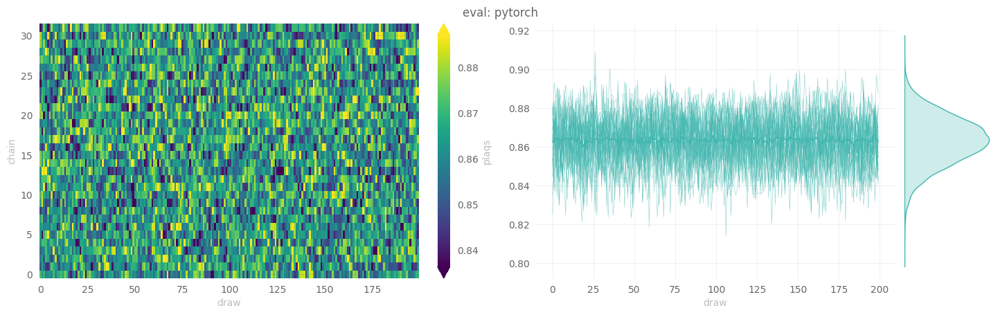

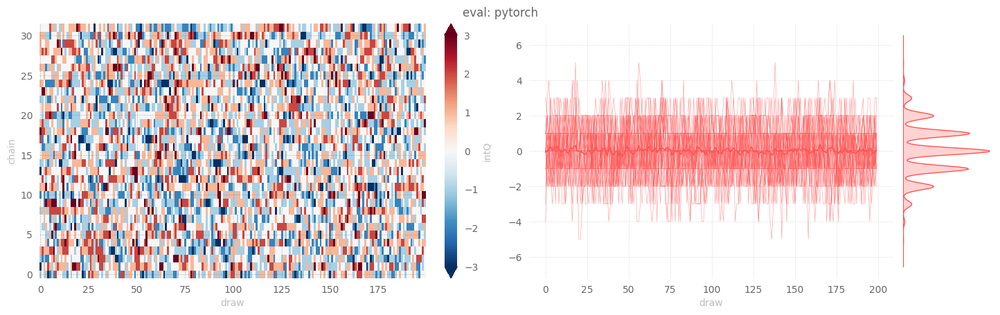

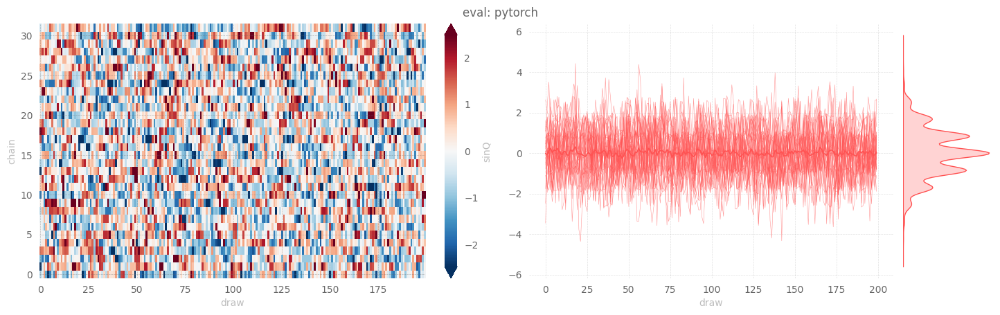

In [14]:
outputs['pytorch']['eval'] = ptExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='eval', nchains=32)

In [ ]:
for k, v in ptExpSU3.trainer.dy

#### HMC

[06/09/23 12:40:51][WARNING][trainer.py:435] - Step size `eps` not specified for HMC! Using default: 0.1000 for generic HMC
[06/09/23 12:40:51][WARNING][trainer.py:435] - x.shape (original): torch.Size([4096, 2, 16, 16])
[06/09/23 12:40:51][WARNING][trainer.py:435] - x[:nchains].shape: torch.Size([128, 2, 16, 16])
[06/09/23 12:40:51][INFO][trainer.py:1051] - eps=0.1
beta=4.0
nlog=10
table=<rich.table.Table object at 0x7f692cb9cd60>
nprint=500
eval_steps=2000
nleapfrog=20


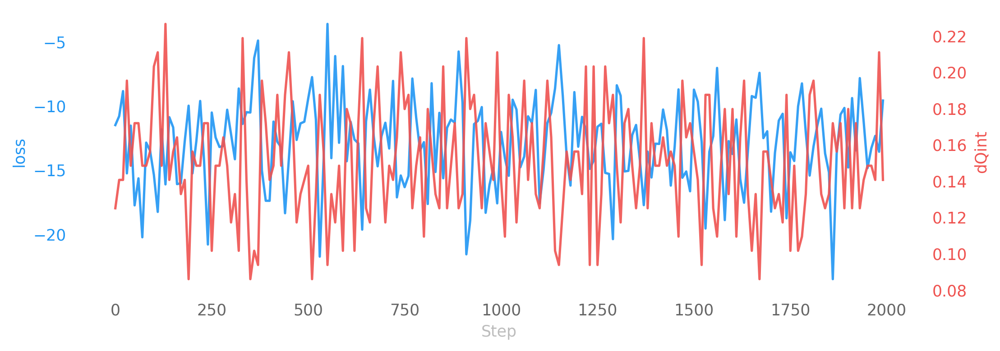

[06/09/23 12:40:55][INFO][trainer.py:1181] - hstep=0 dt=0.035 beta=4.000 loss=-11.506 dQsin=0.262 dQint=0.125 energy=395.874 logprob=395.874 logdet=0.000 acc=0.820 sumlogdet=0.000 acc_mask=0.828 plaqs=0.861 intQ=-0.109 sinQ=-0.074
[06/09/23 12:41:25][INFO][trainer.py:1181] - hstep=500 dt=0.033 beta=4.000 loss=-9.443 dQsin=0.252 dQint=0.148 energy=395.877 logprob=395.877 logdet=0.000 acc=0.834 sumlogdet=0.000 acc_mask=0.852 plaqs=0.862 intQ=-0.094 sinQ=-0.092
[06/09/23 12:41:56][INFO][trainer.py:1181] - hstep=1000 dt=0.033 beta=4.000 loss=-12.043 dQsin=0.270 dQint=0.141 energy=394.240 logprob=394.240 logdet=0.000 acc=0.821 sumlogdet=0.000 acc_mask=0.859 plaqs=0.864 intQ=0.117 sinQ=0.111
[06/09/23 12:42:28][INFO][trainer.py:1181] - hstep=1500 dt=0.032 beta=4.000 loss=-8.744 dQsin=0.238 dQint=0.156 energy=397.819 logprob=397.819 logdet=0.000 acc=0.808 sumlogdet=0.000 acc_mask=0.773 plaqs=0.863 intQ=0.172 sinQ=0.168
[06/09/23 12:43:02][INFO][plot_helpers.py:1005] - Saving figure to: /lus/g

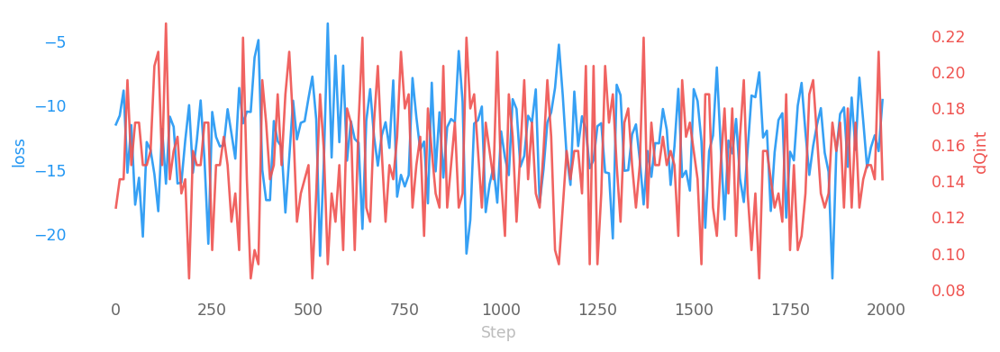

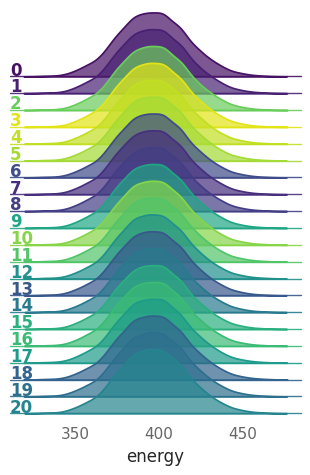

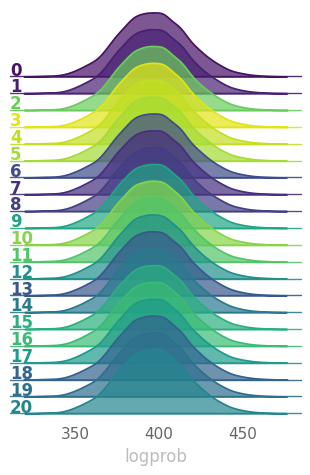

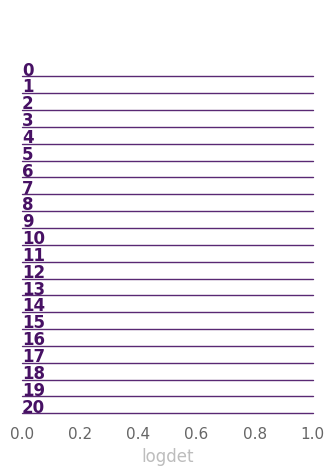

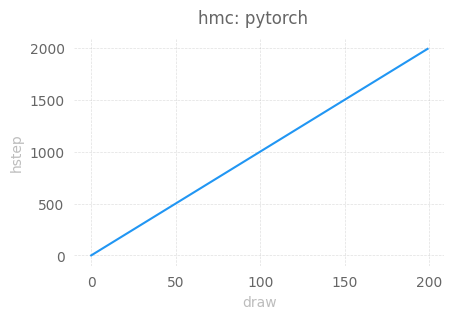

...

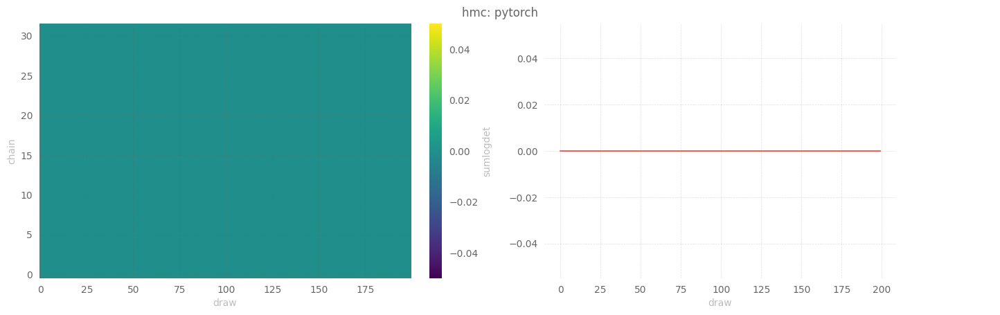

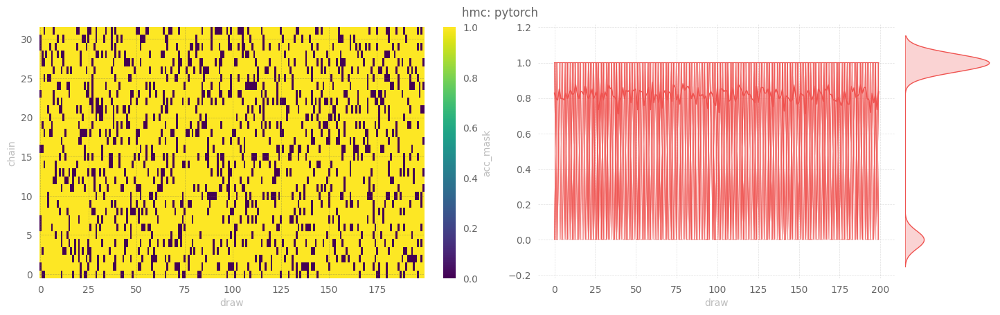

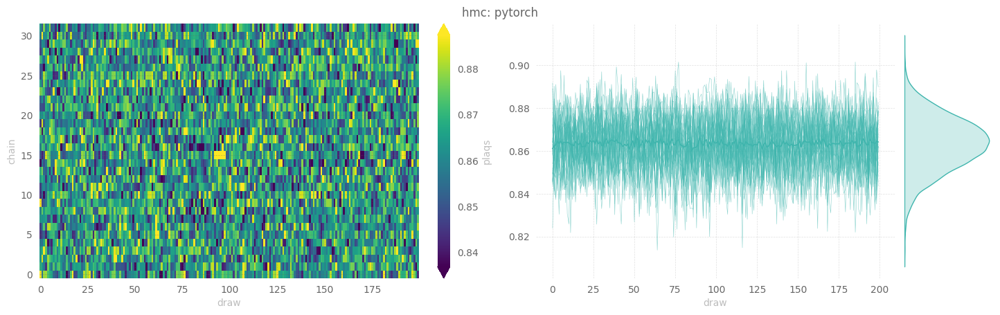

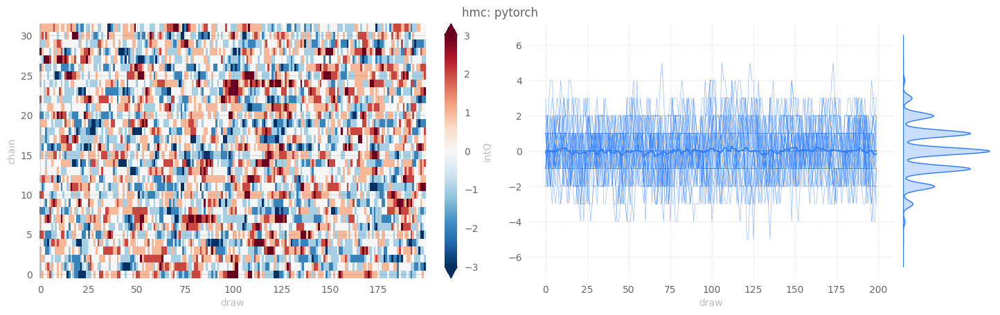

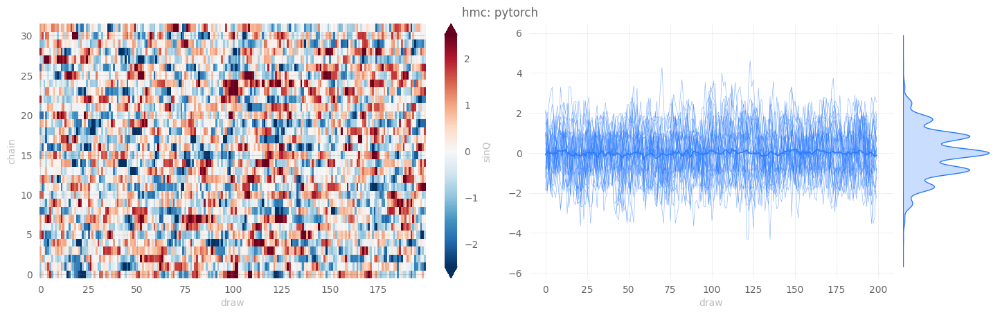

In [15]:
outputs['pytorch']['hmc'] = ptExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='hmc', nchains=32)

## TensorFlow

### Train

[06/04/23 18:24:33][INFO][trainer.py:200] - Looking for checkpoints in: /lus/grand/projects/datascience/foremans/locations/thetaGPU/projects/saforem2/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow
[06/04/23 18:24:33][INFO][trainer.py:200] - No checkpoints found to load from. Continuing


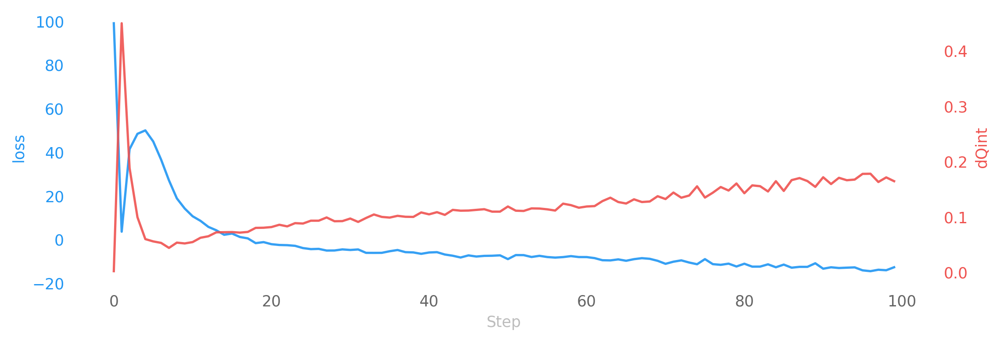

[06/04/23 18:24:33][INFO][trainer.py:1266] - ERA: 0 / 1, BETA: 4.000
[06/04/23 18:25:55][INFO][trainer.py:200] - Thermalizing configs @ 4.00 took 82.2241 s


Training:   0%|          | 0/2000 [00:00<?, ?it/s]

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
[06/04/23 18:27:24][INFO][trainer.py:1089] - era=0 epoch=0 tstep=1.000 dt=88.120 beta=4.000 loss=99.048 dQsin=0.001 dQint=0.002 energy=1259.783 logprob=1261.410 logdet=-1.627 sldf=-0.678 sldb=-0.158 sld=-1.627 xeps=0.100 veps=0.100 acc=0.001 sumlogdet=-0.002 acc_mask=0.001 plaqs=0.046 intQ=-0.084 sinQ=-0.018 lr=0.001
[06/04/23 18:28:35][INFO][trainer.py:1089] - era=0 epoch=240 tstep=241.000 dt=0.260 beta=4.000 loss=5.809 dQsin=0.112 dQint=0.065 energy=398.068 logprob=397.774 logdet=0.294 sldf=0.172 sldb=-0.280 sld=0.294 xeps=0.079 veps=0.071 acc=0.329 sumlogdet=-0.005 acc_mask=0.333 plaqs=0.863 intQ=0.020 sinQ=0.017 lr=0.001
[06/04/23 18:29:47][INFO][trainer.py:1089] - era=0 epoch=500 tstep=501.000 dt=0.268 beta=4.000 loss=-4.374 dQsin=0.173 dQint=0.093 energy=395.991 logprob=397.147 logd

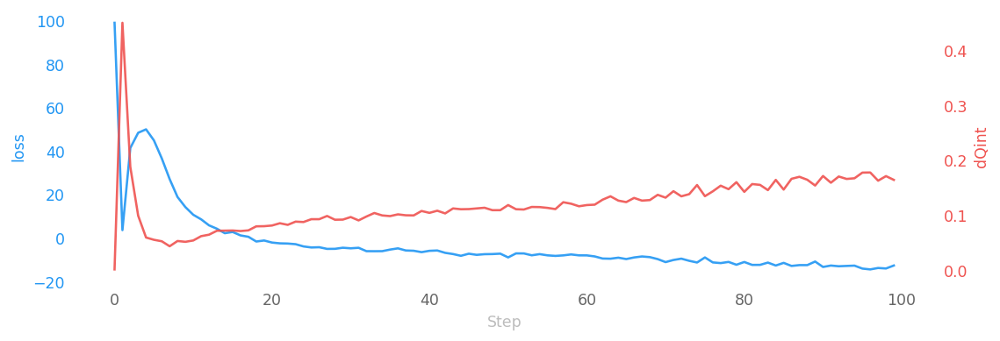

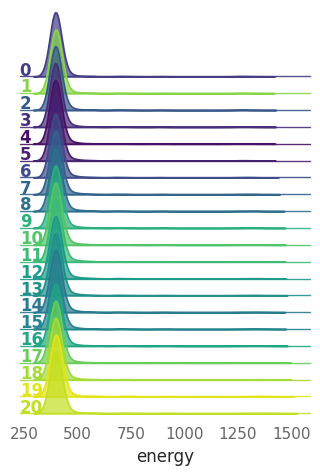

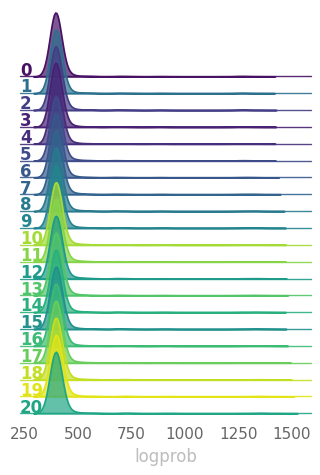

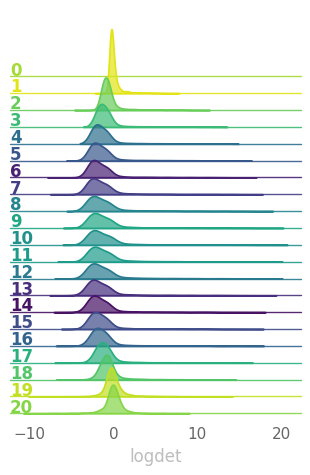

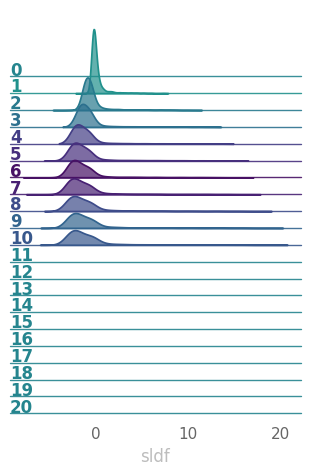

...

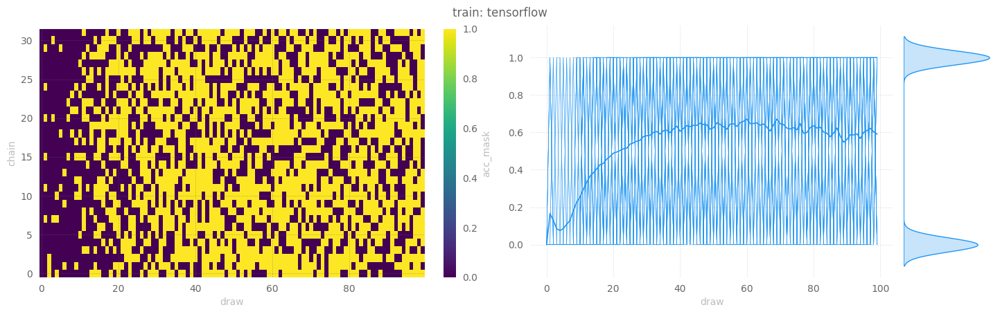

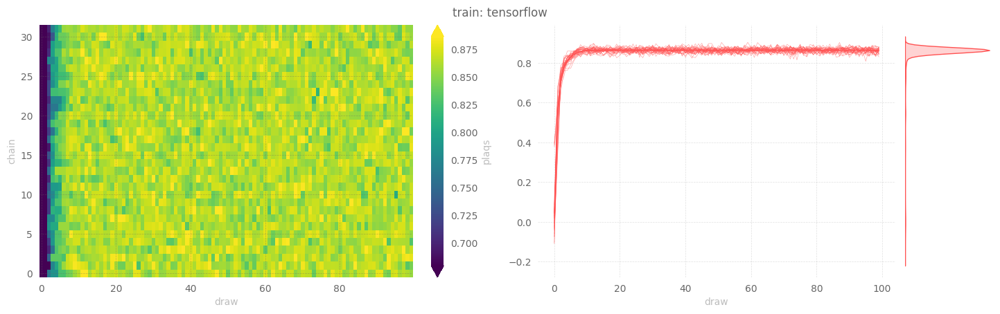

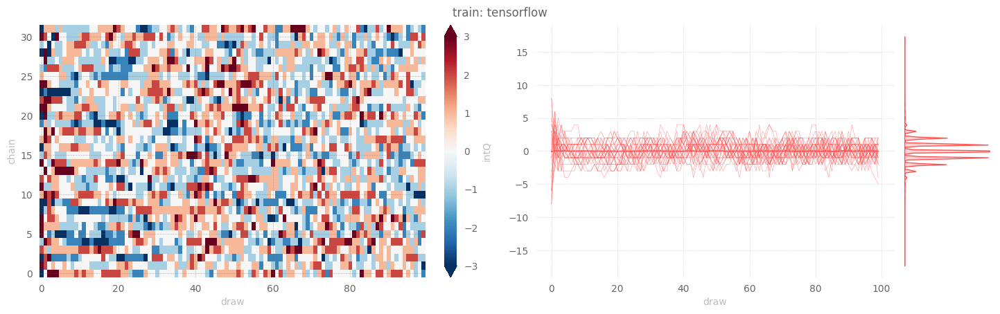

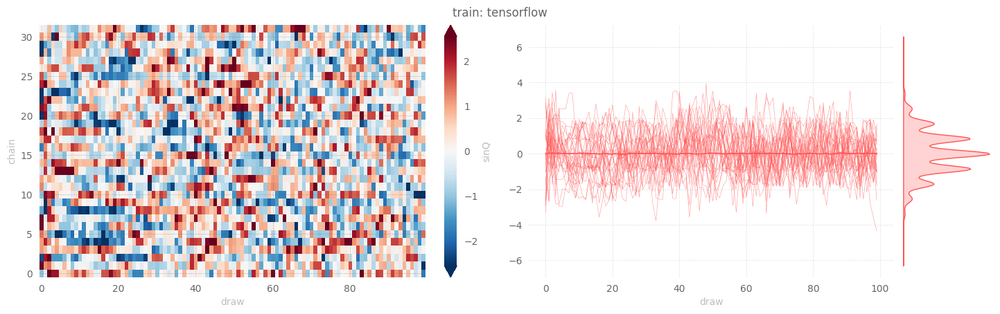

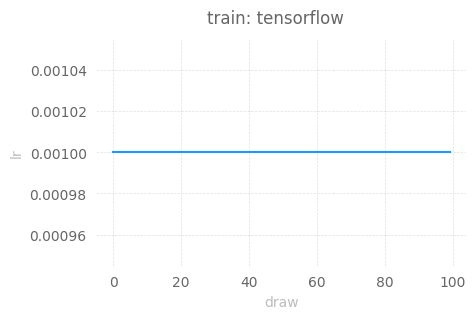

In [15]:
outputs['tensorflow']['train'] = tfExpU1.trainer.train()
_ = tfExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluate

[06/04/23 19:02:48][WARNING][trainer.py:196] - x.shape (original): (4096, 2, 16, 16)
[06/04/23 19:02:48][WARNING][trainer.py:196] - x[:nchains].shape: (128, 2, 16, 16)
[06/04/23 19:02:48][INFO][trainer.py:200] - eps = None
beta = 4.0
nlog = 10
table = <rich.table.Table object at 0x7f8c287428f0>
nprint = 500
eval_steps = 2000
nleapfrog = None


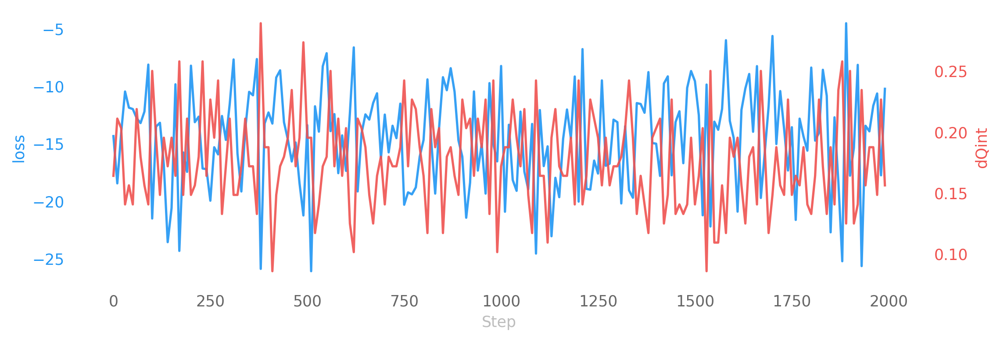

  0%|          | 0/2000 [00:00<?, ?it/s]

[06/04/23 19:04:23][INFO][trainer.py:200] - estep=0 dt=11.699 beta=4.000 loss=-14.340 dQsin=0.237 dQint=0.164 energy=397.465 logprob=397.759 logdet=-0.294 sldf=-0.145 sldb=-0.163 sld=-0.294 xeps=0.115 veps=0.099 acc=0.579 sumlogdet=-0.037 acc_mask=0.578 plaqs=0.864 intQ=-0.070 sinQ=-0.075
[06/04/23 19:05:22][INFO][trainer.py:200] - estep=500 dt=0.050 beta=4.000 loss=-13.389 dQsin=0.262 dQint=0.195 energy=398.436 logprob=398.704 logdet=-0.269 sldf=-0.130 sldb=-0.163 sld=-0.269 xeps=0.115 veps=0.099 acc=0.642 sumlogdet=-0.014 acc_mask=0.617 plaqs=0.863 intQ=0.180 sinQ=0.101
[06/04/23 19:06:07][INFO][trainer.py:200] - estep=1000 dt=0.052 beta=4.000 loss=-8.242 dQsin=0.225 dQint=0.172 energy=394.759 logprob=395.069 logdet=-0.310 sldf=-0.150 sldb=-0.163 sld=-0.310 xeps=0.115 veps=0.099 acc=0.600 sumlogdet=-0.030 acc_mask=0.633 plaqs=0.865 intQ=-0.078 sinQ=-0.083
[06/04/23 19:06:53][INFO][trainer.py:200] - estep=1500 dt=0.050 beta=4.000 loss=-9.561 dQsin=0.227 dQint=0.141 energy=397.790 logp

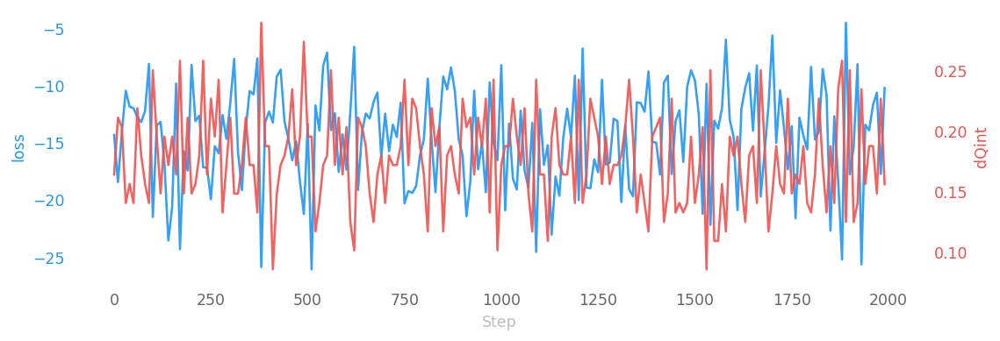

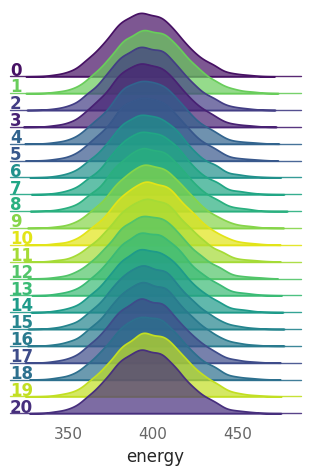

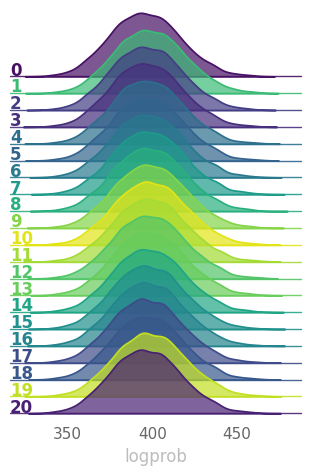

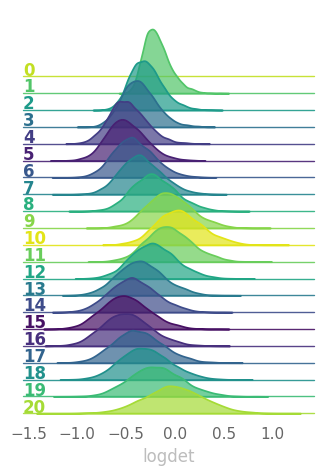

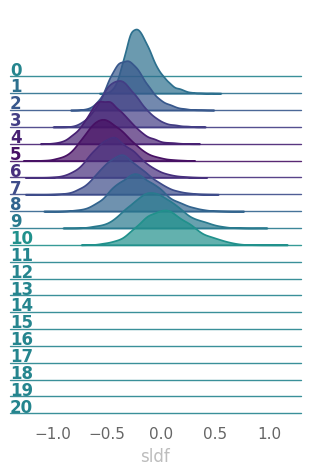

...

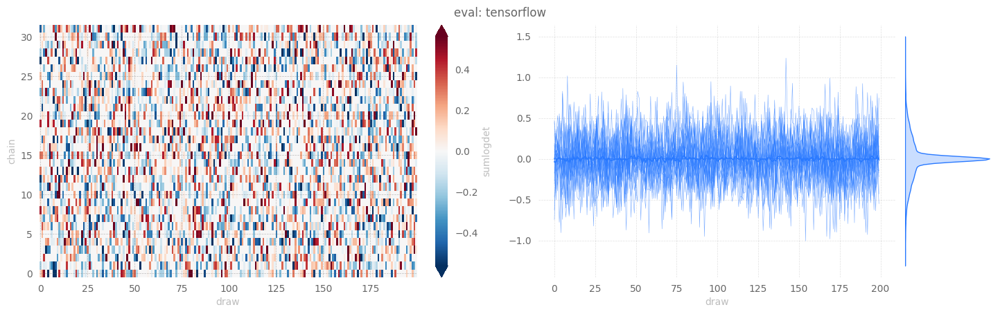

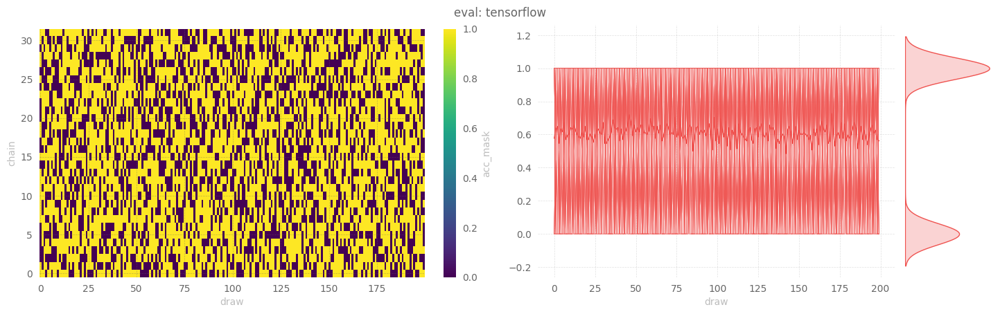

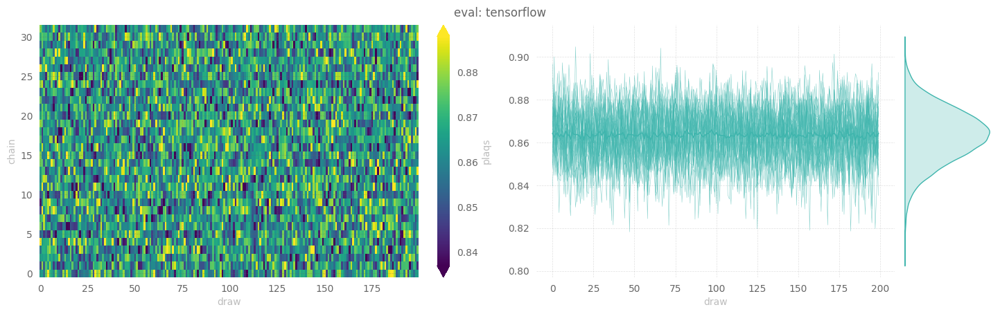

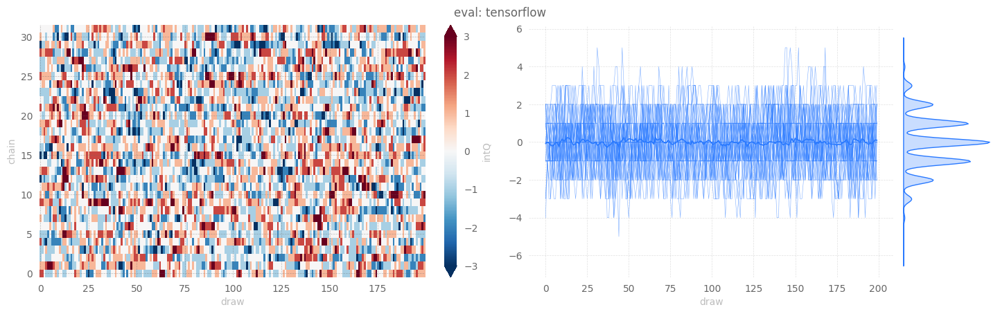

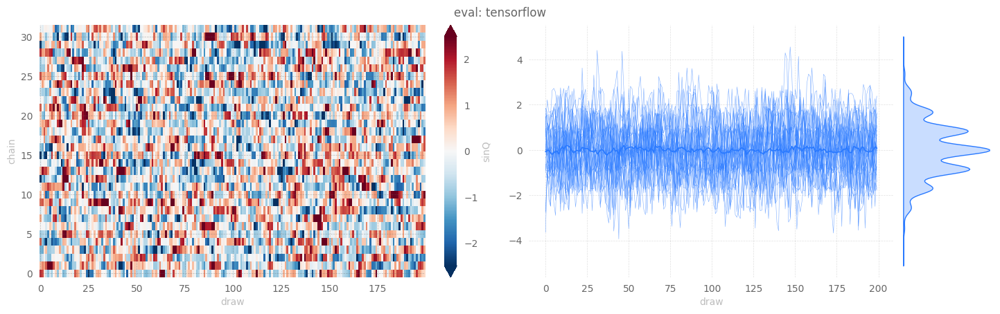

In [16]:
outputs['tensorflow']['eval'] = tfExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='eval', nchains=32)

#### HMC

[06/04/23 19:08:54][WARNING][trainer.py:196] - Step size `eps` not specified for HMC! Using default: 0.1000 for generic HMC
[06/04/23 19:08:55][WARNING][trainer.py:196] - x.shape (original): (4096, 2, 16, 16)
[06/04/23 19:08:55][WARNING][trainer.py:196] - x[:nchains].shape: (128, 2, 16, 16)
[06/04/23 19:08:55][INFO][trainer.py:200] - eps = 0.1
beta = 4.0
nlog = 10
table = <rich.table.Table object at 0x7f7e20154250>
nprint = 500
eval_steps = 2000
nleapfrog = 20


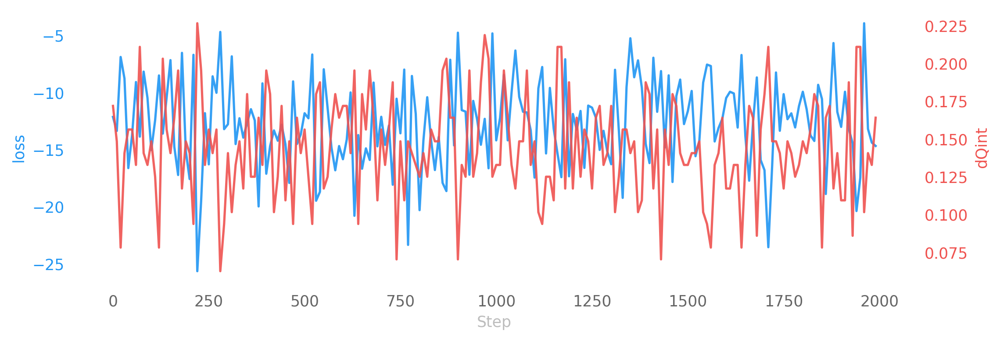

  0%|          | 0/2000 [00:00<?, ?it/s]

[06/04/23 19:10:20][INFO][trainer.py:200] - hstep=0 dt=1.108 beta=4.000 loss=-12.134 dQsin=0.276 dQint=0.172 energy=397.155 logprob=397.155 logdet=0.000 acc=0.824 sumlogdet=0.000 acc_mask=0.812 plaqs=0.863 intQ=0.211 sinQ=0.208
[06/04/23 19:12:20][INFO][trainer.py:200] - hstep=500 dt=0.193 beta=4.000 loss=-11.813 dQsin=0.271 dQint=0.156 energy=397.082 logprob=397.082 logdet=0.000 acc=0.825 sumlogdet=0.000 acc_mask=0.883 plaqs=0.863 intQ=0.023 sinQ=0.002
[06/04/23 19:14:20][INFO][trainer.py:200] - hstep=1000 dt=0.193 beta=4.000 loss=-14.191 dQsin=0.282 dQint=0.133 energy=393.459 logprob=393.459 logdet=0.000 acc=0.811 sumlogdet=0.000 acc_mask=0.828 plaqs=0.864 intQ=-0.094 sinQ=-0.102
[06/04/23 19:16:21][INFO][trainer.py:200] - hstep=1500 dt=0.193 beta=4.000 loss=-11.627 dQsin=0.254 dQint=0.133 energy=395.414 logprob=395.414 logdet=0.000 acc=0.811 sumlogdet=0.000 acc_mask=0.820 plaqs=0.864 intQ=0.133 sinQ=0.087
[06/04/23 19:18:27][INFO][plot_helpers.py:1005] - Saving figure to: /lus/grand

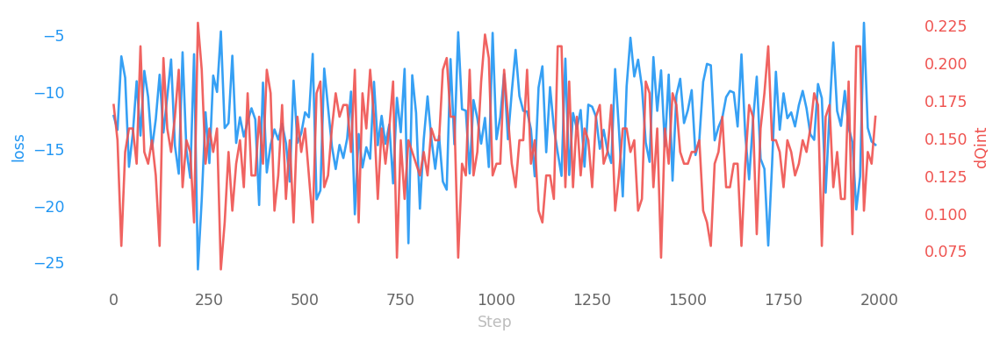

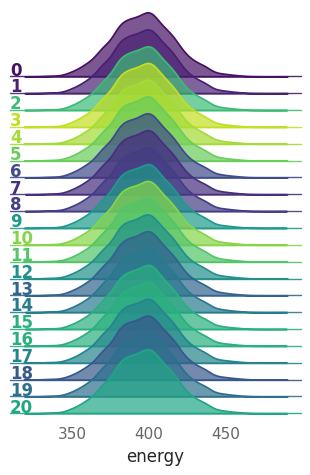

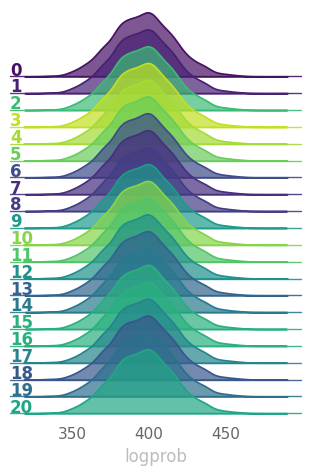

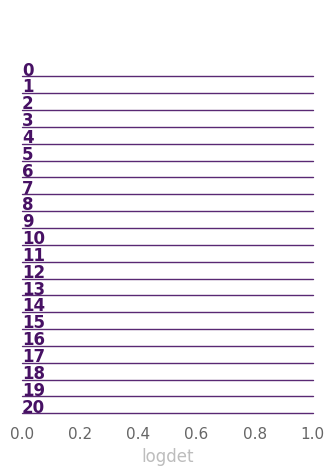

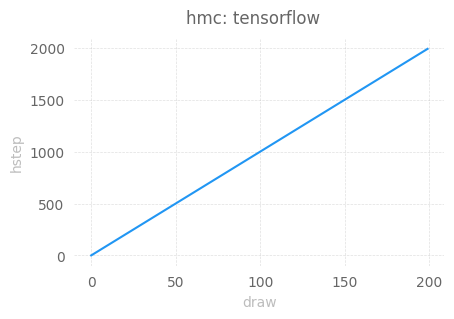

...

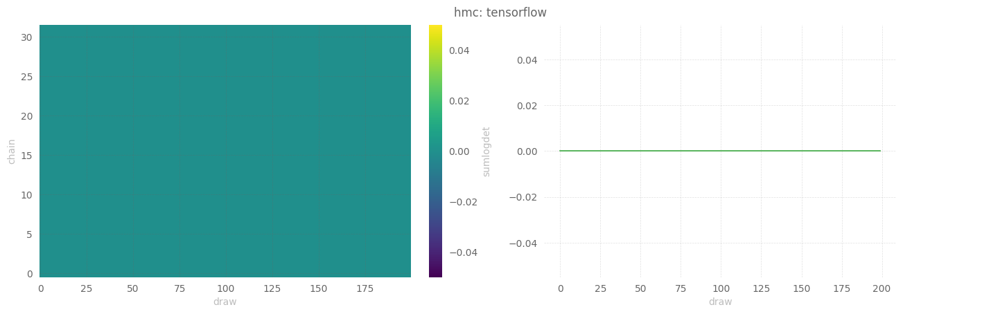

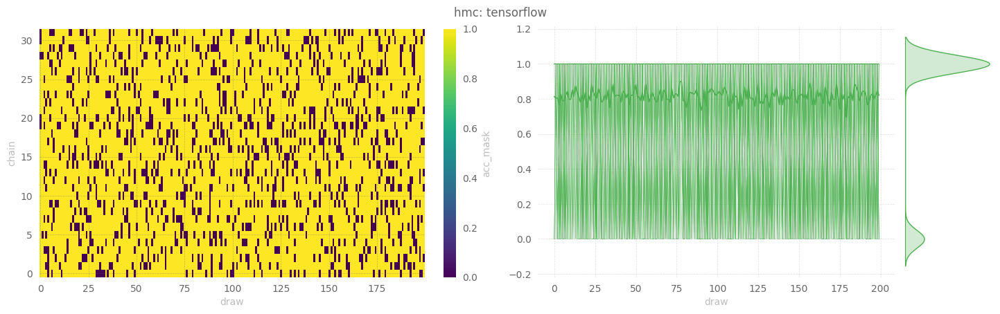

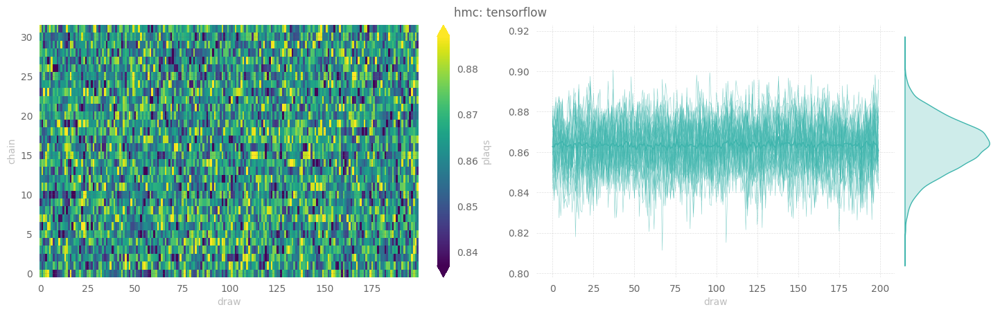

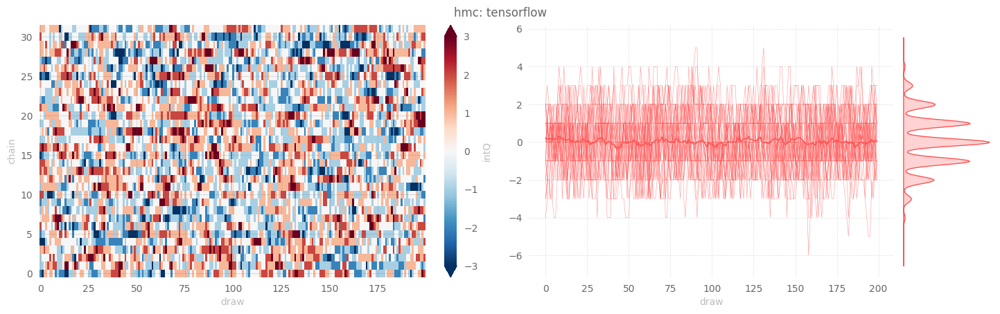

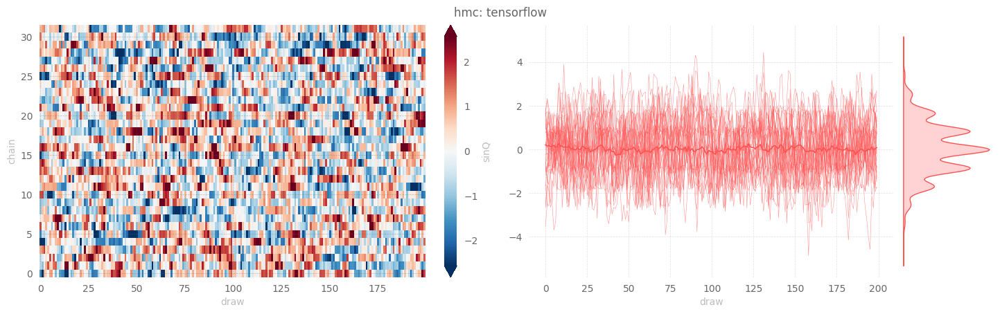

In [17]:
outputs['tensorflow']['hmc'] = tfExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='hmc', nchains=32)

# Model Performance

Our goal is improving the efficiency of our MCMC sampler.

In particular, we are interested in generating **independent** save_datasetrations which we can then use to calculate expectation values of physical observables.

For our purposes, we are interested in obtaining lattice configurations from distinct _topological charge sectors_, as characterized by a configurations _topological charge_, $Q$.

HMC is known to suffer from _critical slowing down_, a phenomenon in which our configurations remains stuck in some local topological charge sector and fails to produce distinct configurations.

In particular, it is known that the integrated autocorrelation time of the topological charge $\tau$ grows exponentially with decreasing lattice spacing (i.e. continuum limit), making this theory especially problematic.

Because of this, we can assess our models' performance by looking at the _tunneling rate_, i.e. the rate at which our sampler jumps between these different charge sectors.

We can write this quantity as:

$$
\delta Q = |Q^{(i)} - Q^{(i-1)}|
$$

where we look at the difference in the topological charge between sequential configurations.

<div class="alert alert-block alert-info" style="background:rgba(34,139,230,0.1); color: rgb(34,139,230); border: 0px solid; border-radius:5px;">
<b>Note:</b> 
The efficiency of our sampler is directly proportional to the tunneling rate, which is inversely proportional to the integrated autocorrelation time $\tau$, i.e.

&nbsp;

$$
\text{Efficiency} \propto \delta Q \propto \frac{1}{\tau}
$$

Explicitly, this means that the **more efficient** the model $\longrightarrow$

- the **larger** tunneling rate
- the **smaller** integrated autocorrelation time for $Q$
</div>

In [18]:
import xarray as xr

def get_thermalized_configs(
        x: np.ndarray | xr.DataArray,
        drop: int = 5
) -> np.ndarray | xr.DataArray:
    """Drop the first `drop` states across all chains.

    x.shape = [draws, chains]
    """
    if isinstance(x, np.ndarray):
        return np.sort(x)[..., :-drop]
    if isinstance(x, xr.DataArray):
        return x.sortby(
            ['chain', 'draw'],
            ascending=False
        )[..., :-drop]
    raise TypeError

# Comparisons

We can measure our models' performance explicitly by looking at the average tunneling rate, $\delta Q_{\mathbb{Z}}$, for our **trained model** and comparing it against generic HMC.

Recall,

$$\delta Q_{\mathbb{Z}} := \big|Q^{(i+1)}_{\mathbb{Z}} - Q^{(i)}_{\mathbb{Z}}\big|$$

where a **higher** value of $\delta Q_{\mathbb{Z}}$ corresponds to **better** tunneling of the topological charge, $Q_{\mathbb{Z}}$.

Note that we can get a concise representation of the data from different parts of our run via:

Note that the data from each of the different parts of our experiment (i.e. `train`, `eval`, and `hmc`) are stored as a dict, e.g.

```python
>>> list(ptExpU1.trainer.histories.keys())
['train', 'eval', 'hmc']
>>> train_history = ptExpU1.trainer.histories['train']
>>> train_dset = train_history.get_dataset()
>>> assert isinstance(train_history, l2hmc.utils.history.BaseHistory)
>>> assert isinstance(train_dset, xarray.Dataset)
```

(see below, for example)

We aggregate the data into the `dsets` dict below, grouped by:

1. **Framework** (`pytorch` / `tensorflow`)
2. **Job type** (`train`, `eval`, `hmc`)

In [19]:
import logging
log = logging.getLogger(__name__)
dsets = {}
fws = ['pt', 'tf']
modes = ['train', 'eval', 'hmc']
for fw in fws:
    dsets[fw] = {}
    for mode in modes:
        hist = None
        if fw == 'pt':
            hist = ptExpU1.trainer.histories.get(mode, None)
        elif fw == 'tf':
            hist = tfExpU1.trainer.histories.get(mode, None)
        if hist is not None:
            log.info(f'Getting dataset for {fw}: {mode}')
            dsets[fw][mode] = hist.get_dataset()

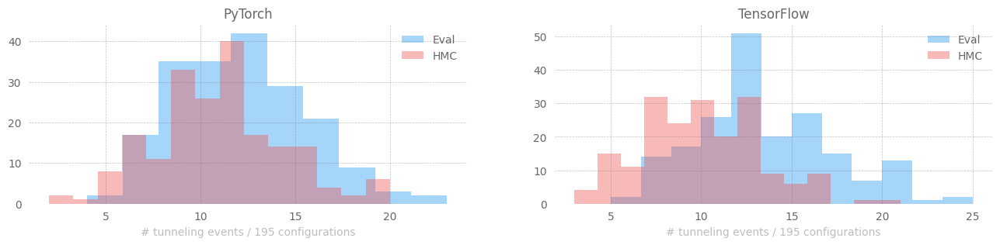

In [20]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import COLORS, set_plot_style

set_plot_style()

fig, ax = plt.subplots(figsize=(16, 3), ncols=2)

# ---------------------------------------------
# ---- DROP FIRST 20% FOR THERMALIZATION ------
# ---------------------------------------------
KEEP = int(0.8 * len(dsets['tf']['eval'].draw))
dqpte = get_thermalized_configs(dsets['pt']['eval']['dQint'].astype('int'))
dqpth = get_thermalized_configs(dsets['pt']['hmc']['dQint'].astype('int'))

dqtfe = get_thermalized_configs(dsets['tf']['eval']['dQint'].astype('int'))
dqtfh = get_thermalized_configs(dsets['tf']['hmc']['dQint'].astype('int'))

_ = sns.distplot(
    dqpte.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[0]
)
_ = sns.distplot(
    dqpth.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[0]
)

_ = ax[0].set_title('PyTorch')
_ = ax[0].set_xlabel(
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[0].legend(loc='best', frameon=False)
plt.legend()

_ = sns.distplot(
    dqtfe.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[1]
)
_ = sns.distplot(
    dqtfh.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[1]
)

_ = ax[1].set_title('TensorFlow')
_ = ax[1].set_xlabel(
    #r"""$\sum_{i=0} \left|\delta Q_{i}\right|$""",
    #fontsize='large',
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[1].legend(loc='best', frameon=False)

## TensorFlow Results

In [21]:
import rich

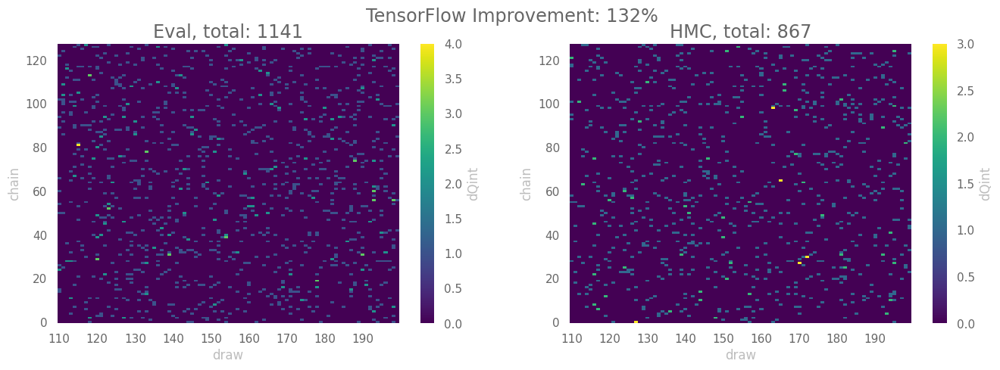

In [22]:
sns.set_context('notebook')
ndraws = len(dsets['tf']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['tf']['eval']['dQint'][:, -90:]
dqh = dsets['tf']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'TensorFlow Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"TensorFlow, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T}")
log.info(f"TensorFlow, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T}")

### PyTorch Results

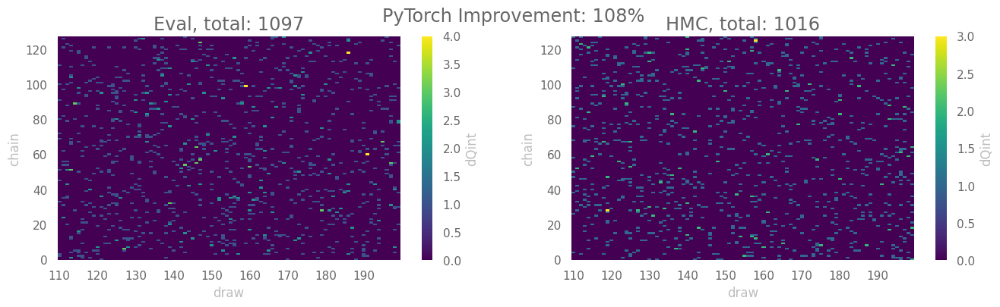

In [23]:
sns.set_context('notebook')
ndraws = len(dsets['pt']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['pt']['eval']['dQint'][:, -90:]
dqh = dsets['pt']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], 0.8 * fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'PyTorch Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(60 * '-')
log.info(f"PyTorch, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T.values}")
log.info(60 * '-')
log.info(f"PyTorch, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T.values}")

## Comparisons

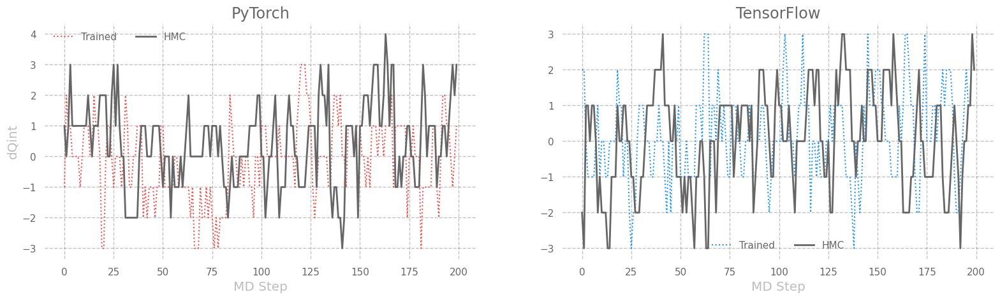

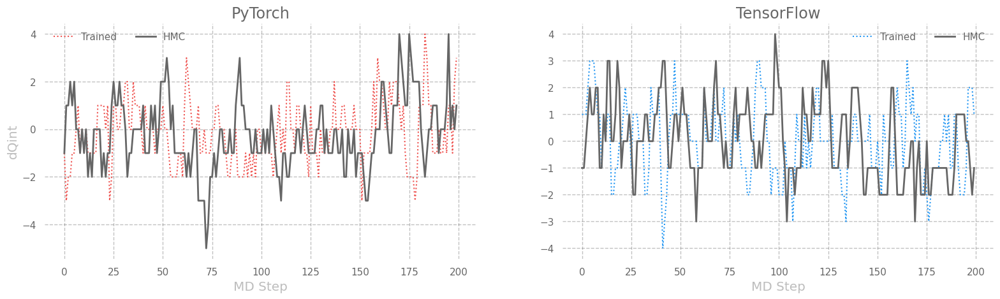

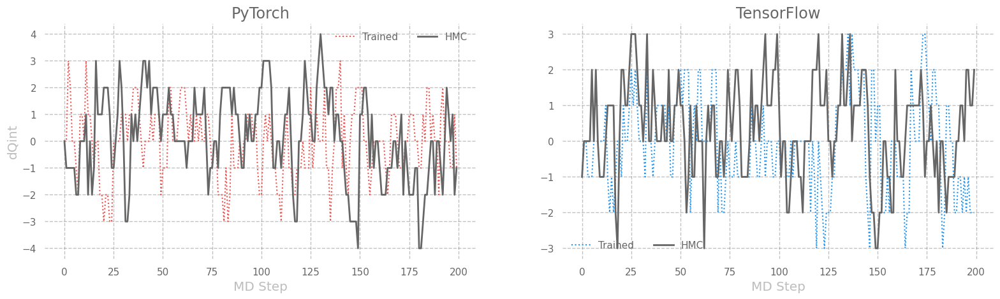

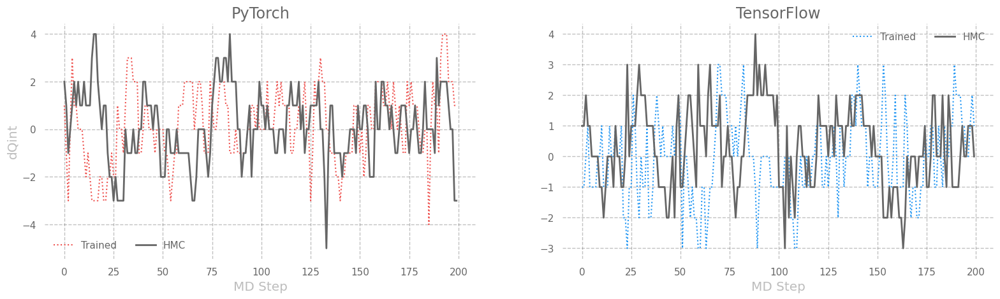

In [24]:
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import set_plot_style, COLORS

import seaborn as sns
set_plot_style()
plt.rcParams['axes.linewidth'] = 2.0
sns.set_context('notebook')
figsize = plt.rcParamsDefault['figure.figsize']
plt.rcParams['figure.dpi'] = plt.rcParamsDefault['figure.dpi']

for idx in range(4):
    fig, (ax, ax1) = plt.subplots(
        ncols=2,
        #nrows=4,
        figsize=(3. * figsize[0], figsize[1]),
    )
    _ = ax.plot(
        dsets['pt']['eval'].intQ[idx],  # .dQint.mean('chain')[100:],
        color=COLORS['red'],
        ls=':',
        label='Trained',
        lw=1.5,
    );

    _ = ax.plot(
        dsets['pt']['hmc'].intQ[idx],  # .dQint.mean('chain')[100:],
        ls='-',
        label='HMC',
        color='#666666',
        zorder=5,
        lw=2.0,
    );

    _ = ax1.plot(
        dsets['tf']['eval'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color=COLORS['blue'],
        ls=':',
        label='Trained',
        lw=1.5,

    );
    _ = ax1.plot(
        dsets['tf']['hmc'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color='#666666',
        ls='-',
        label='HMC',
        zorder=5,
        lw=2.0,
    );
    _ = ax.set_title('PyTorch', fontsize='x-large')
    _ = ax1.set_title('TensorFlow', fontsize='x-large')
    #_ = ax1.set_ylim(ax.get_ylim())
    _ = ax.grid(True, alpha=0.4)
    _ = ax1.grid(True, alpha=0.4)
    _ = ax.set_xlabel('MD Step', fontsize='large')
    _ = ax1.set_xlabel('MD Step', fontsize='large')
    _ = ax.set_ylabel('dQint', fontsize='large')
    _ = ax.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#666666')
    _ = ax1.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#666666')